# Exercise 2 report

### By Jakob Kallestad, Eirik Norseng, Eirik Rikstad
---

In [96]:
# About retinanet:

----

# Choice of network and infrastructure:

We decided to use a well known and well maintained implementation of RetinaNet object detection called Keras-Retinanet from https://github.com/fizyr/keras-retinanet/blob/master/README.md. This implementation is described in [Focal Loss for Dense Object Detection](https://arxiv.org/abs/1708.02002) by Tsung-Yi Lin, Priya Goyal, Ross Girshick, Kaiming He and Piotr Dollár (2017). More on this later.

  ---

# Preparing the SVHN dataset:

First we needed to prepare the SVHN dataset. We downloaded the raw images from [ufldl.stanford.edu](http://ufldl.stanford.edu/housenumbers) and extracted the images to disk.

In [1]:
import cv2
import tqdm
import h5py
import pandas as pd
from sklearn.model_selection import train_test_split

## Download SVHN Dataset:

In [2]:
#!wget http://ufldl.stanford.edu/housenumbers/train.tar.gz
#!wget http://ufldl.stanford.edu/housenumbers/test.tar.gz
#!wget http://ufldl.stanford.edu/housenumbers/extra.tar.gz

## Unzip the SVHN Dataset:

In [3]:
#!tar -xf train.tar.gz
#!tar -xf test.tar.gz
#!tar -xf extra.tar.gz

## Preprocess annotation data:

In [2]:
# Source: https://stackoverflow.com/questions/41176258/h5py-access-data-in-datasets-in-svhn?rq=1

# Get metadata from digitStruct.mat file
def get_box_data(index, hdf5_data):
    meta_data = dict()
    meta_data['height'] = []
    meta_data['label'] = []
    meta_data['left'] = []
    meta_data['top'] = []
    meta_data['width'] = []

    def print_attrs(name, obj):
        vals = []
        if obj.shape[0] == 1:
            vals.append(obj[0][0])
        else:
            for k in range(obj.shape[0]):
                vals.append(int(hdf5_data[obj[k][0]][0][0]))
        meta_data[name] = vals

    box = hdf5_data['/digitStruct/bbox'][index]
    hdf5_data[box[0]].visititems(print_attrs)
    return meta_data

def get_name(index, hdf5_data):
    name = hdf5_data['/digitStruct/name']
    return ''.join([chr(v[0]) for v in hdf5_data[name[index][0]].value])

In [3]:
# Put metadata into lists
train_pics = []
train_boxes = []
test_pics = []
test_boxes = []

In [4]:
def metadata_to_lists(folder_name):
    pics = []
    boxes = []
    mat_data = h5py.File('{}/digitStruct.mat'.format(folder_name), 'r')
    size = mat_data['/digitStruct/name'].size
    for i in tqdm.tqdm(range(size)):
        pics.append((get_name(i, mat_data), folder_name))
        boxes.append(get_box_data(i, mat_data))
    return pics, boxes

In [5]:
train_pics, train_boxes = metadata_to_lists('train')
extra_pics, extra_boxes = metadata_to_lists('extra')
test_pics, test_boxes = metadata_to_lists('test')

train_pics = train_pics + extra_pics
train_boxes = train_boxes + extra_boxes

print(len(train_pics))
print(len(test_pics))

train_pics, val_pics, train_boxes, val_boxes = train_test_split(train_pics, train_boxes, test_size=0.1, random_state=42)

print(len(train_pics))
print(len(val_pics))
print(len(test_pics))

100%|██████████| 13068/13068 [01:09<00:00, 187.46it/s]


235755
13068
212179
23576
13068


### Annotations format  

We converted the annotations to match the expected format of keras-retinanet which is explained on their [github](https://github.com/fizyr/keras-retinanet) as follows: 


`The CSV file with annotations should contain one annotation per line. Images with multiple bounding boxes should use one row per bounding box. Note that indexing for pixel values starts at 0. The expected format of each line is:`  
```python 
path/to/image.jpg,x1,y1,x2,y2,class_name
```  

source: [Keras-Retinanet on Github](https://github.com/fizyr/keras-retinanet)

In [6]:
def create_annotation(pics, boxes):
    annotation = dict()
    annotation["1_img_path"] = []
    annotation["2_xmin"] = []
    annotation["3_ymin"] = []
    annotation["4_xmax"] = []
    annotation["5_ymax"] = []
    annotation["6_class_name"] = []

    for i in tqdm.tqdm(range(len(pics))):
        im = cv2.imread(pics[i][1]+'/'+pics[i][0])
        for j in range(len(boxes[i]['height'])):
            annotation["1_img_path"].append(pics[i][1]+'/'+pics[i][0])
            annotation["2_xmin"].append(min(im.shape[1]-1, max(0, int(boxes[i]['left'][j]))))
            annotation["3_ymin"].append(min(im.shape[0]-1, max(0, int(boxes[i]['top'][j]))))
            annotation["4_xmax"].append(min(im.shape[1], int(boxes[i]['left'][j] + boxes[i]['width'][j])))
            annotation["5_ymax"].append(min(im.shape[0], int(boxes[i]['top'][j] + boxes[i]['height'][j])))
            annotation["6_class_name"].append(int(boxes[i]['label'][j]))
    df = pd.DataFrame(annotation)
    return df

In [7]:
df_train = create_annotation(train_pics, train_boxes)
df_validate = create_annotation(val_pics, val_boxes)
df_test = create_annotation(test_pics, test_boxes)

100%|██████████| 13068/13068 [00:18<00:00, 693.46it/s]


## Put annotation data into csv files

In [8]:
df_train.to_csv('svhn_annotate_train.csv', header=None, index=None)
df_validate.to_csv('svhn_annotate_validate.csv', header=None, index=None)
df_test.to_csv('svhn_annotate_test.csv', header=None, index=None)

In [9]:
classes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
with open('svhn_classes.csv', 'w') as file:
    for i, line in enumerate(classes):
        file.write('{},{}\n'.format(line,i))

----  

----  

# Preparing the FISH dataset:
We also prepared the FISH dataset in a similar way. We downloaded the zip file from [http://www.ii.uib.no/~ketil/fish-data.tgz](http://www.ii.uib.no/~ketil/fish-data.tgz) and extracted the images to disk.  

Then we genereated annotation csv files based on the txt files that corresponded to the images by their filename. These csv files also used the expected format of Keras-Retinanet which was explained earlier under __Annotations format__.

In [1]:
import glob
import pandas as pd
import tqdm
from sklearn.model_selection import train_test_split

## Download fish dataset:

In [2]:
# Link to fish dataset (18GB!):
#!wget http://www.ii.uib.no/~ketil/fish-data.tgz

--2020-03-18 20:26:15--  http://www.ii.uib.no/~ketil/fish-data.tgz
Resolving www.ii.uib.no (www.ii.uib.no)... 129.177.16.249
Connecting to www.ii.uib.no (www.ii.uib.no)|129.177.16.249|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 18827162822 (18G) [application/x-gzip]
Saving to: ‘fish-data.tgz’

fish-data.tgz       100%[===================>]  17.53G  17.6MB/s    in 29m 46s 

2020-03-18 20:56:02 (10.1 MB/s) - ‘fish-data.tgz’ saved [18827162822/18827162822]



## Unzip fish dataset:

In [2]:
#!tar -xzf fish-data.tgz

## Preprocess annotation data:

In [15]:
def get_txt_file_paths(foldername):
    txt_file_paths = [filepath for filepath in glob.iglob('{}/*.txt'.format(foldername))]
    return txt_file_paths

In [16]:
txt_file_paths = get_txt_file_paths('img_sim_train_2017_4_species')
print(len(txt_file_paths))
txt_file_paths += get_txt_file_paths('img_sim_train_2018_4_species')
print(len(txt_file_paths))

10000
20000


In [18]:
txt_train_paths, txt_test_paths = train_test_split(txt_file_paths, test_size=0.1, random_state=42)
txt_train_paths, txt_val_paths = train_test_split(txt_train_paths, test_size=0.1, random_state=42)
print("Number of images in training set: ", len(txt_train_paths))
print("Number of images in validation set: ", len(txt_val_paths))
print("Number of images in testing set: ", len(txt_test_paths))

Number of images in training set:  16200
Number of images in validation set:  1800
Number of images in testing set:  2000


In [19]:
def txt_annotations_to_csv(txt_paths):
    master_df = pd.DataFrame()
    for path in tqdm.tqdm(txt_paths):
        df = pd.read_csv(path, header = None)
        df[0] = df[0].apply(lambda x: x[45:])
        master_df = master_df.append(df, ignore_index = True)
    return master_df

In [20]:
df_train = txt_annotations_to_csv(txt_train_paths)
df_val = txt_annotations_to_csv(txt_val_paths)
df_test = txt_annotations_to_csv(txt_test_paths)
classes = df_train[5].unique()

print(len(df_train))
print(len(df_val))
print(len(df_test))
print(classes)

100%|██████████| 2000/2000 [00:09<00:00, 207.54it/s]

89203
9808
10997
['bluewhiting' 'mackerel' 'benthosema' 'herring']


## Put annotation data into csv files:

In [26]:
df_train.to_csv('fish_annotate_train.csv', header=None, index=None)
df_val.to_csv('fish_annotate_validate.csv', header=None, index=None)
df_test.to_csv('fish_annotate_test.csv', header=None, index=None)

In [27]:
with open('fish_classes.csv', 'w') as file:
    for i, line in enumerate(sorted(classes)):
        file.write('{},{}\n'.format(line,i))

----

----

## Installing Keras-Retinanet

To install Keras-RetinaNet we ran the following bit of code:

In [1]:
!git clone https://github.com/fizyr/keras-retinanet/
%cd keras-retinanet/
!pip install .
!python3 setup.py build_ext --inplace
%cd ..
print("done")

done


## Training:

For training there is a special command from Keras-RetinaNet that we ran inside a terminal screen window. We started with a resnet50 model pre-trained on the COCO dataset which we downloaded from [here](https://github.com/fizyr/keras-retinanet/releases) For learning rate we used the default of keras-retinanet which starts at 1e-5 and decreases automatically if the loss does not decrease for a few epochs. The final learning rate ended up at 1e-8 for the fish model where we decided to stop the training because the validation accuracy didn't seem to increase much more.  
  
The training procedures took about 1-2 hours per epoch on a Tesla V100 GPU, and we ended up training for 20 epochs for the SVHN model and 10 epochs for the FISH model.  
  
__For SVHN images:__
```python
!retinanet-train \
--weights _pretrained_model.h5 \
--initial-epoch 0 \
--epochs 100 \
--steps 10000 \
--batch-size 4 \
--snapshot-path './svhn_snapshots/' \
--weighted-average \
csv svhn_annotate_train.csv svhn_classes.csv \
--val-annotations svhn_annotate_validate.csv
```

__For FISH images:__
```python
!retinanet-train \
--weights _pretrained_model.h5 \
--initial-epoch 0 \
--epochs 100 \
--steps 10000 \
--batch-size 4 \
--snapshot-path './fish_snapshots/' \
--weighted-average \
csv fish_annotate_train.csv fish_classes.csv \
--val-annotations fish_annotate_validate.csv
```

## Testing:

First we found the path to the most recent SVHN and FISH models.

In [7]:
import os
print(os.path.join('svhn_snapshots', sorted(os.listdir('svhn_snapshots'), reverse=True)[0]))
print(os.path.join('fish_snapshots', sorted(os.listdir('fish_snapshots'), reverse=True)[0]))

svhn_snapshots/resnet50_csv_21.h5
fish_snapshots/resnet50_csv_10.h5


Then we ran the following commands in terminal windows to meassure the models performance on the test data:

In [94]:
!retinanet-evaluate \
--convert-model \
csv svhn_annotate_test.csv svhn_classes.csv \
svhn_snapshots/resnet50_csv_21.h5

Using TensorFlow backend.
2020-03-31 18:24:00.495280: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libnvinfer.so.6
2020-03-31 18:24:00.497176: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libnvinfer_plugin.so.6
Loading model, this may take a second...
2020-03-31 18:24:02.546934: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-03-31 18:24:03.230676: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-03-31 18:24:03.231414: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1555] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 15.75GiB deviceMemoryBandwidth: 836

In [95]:
!retinanet-evaluate \
--convert-model \
csv fish_annotate_test.csv fish_classes.csv \
fish_snapshots/resnet50_csv_10.h5

Using TensorFlow backend.
2020-03-31 18:35:34.133599: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libnvinfer.so.6
2020-03-31 18:35:34.135282: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libnvinfer_plugin.so.6
Loading model, this may take a second...
2020-03-31 18:35:35.376617: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-03-31 18:35:36.054544: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-03-31 18:35:36.055246: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1555] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla V100-SXM2-16GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 15.75GiB deviceMemoryBandwidth: 836

### Results:

mAP for SVHN = __0.87__  
mAP for FISH = __0.93__  
---

## Output Images:

For outputing examples of images with the models predicted bounding boxes and the ground truth bounding boxes we ran retinanet-evalute again, but with --save-path argument and also --score-threshold and --max-detections for nicer looking images.

__For SVHN images:__
```python
!retinanet-evaluate \
--convert-model \
--score-threshold 0.5 \
--max-detections 4 \
--save-path svhn_predicted_images \
csv svhn_annotate_test.csv svhn_classes.csv \
svhn_snapshots/resnet50_csv_21.h5
```

__For FISH images:__
```python
!retinanet-evaluate \
--convert-model \
--score-threshold 0.6 \
--save-path fish_predicted_images \
csv fish_annotate_test.csv fish_classes.csv \
fish_snapshots/resnet50_csv_10.h5
```

## Lets take a look at some of the output images:

In [92]:
svhn_images = [505, 592, 720, 782, 830, 835, 900, 1002, 1004, 1007]
fish_images = [0, 1, 3, 100, 1000, 1001, 1005, 1010, 1015, 1020]

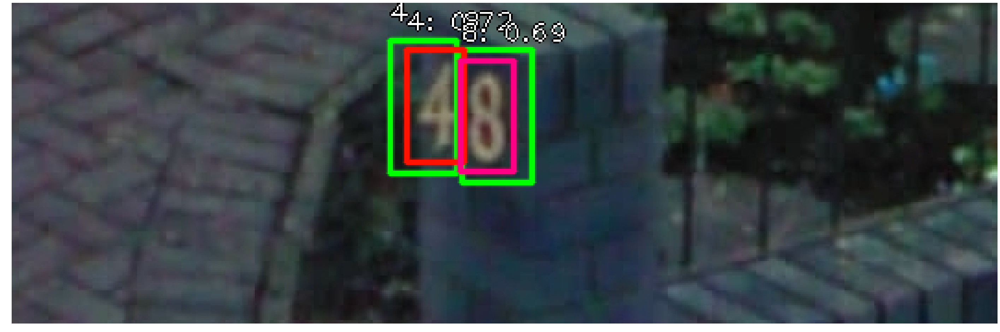

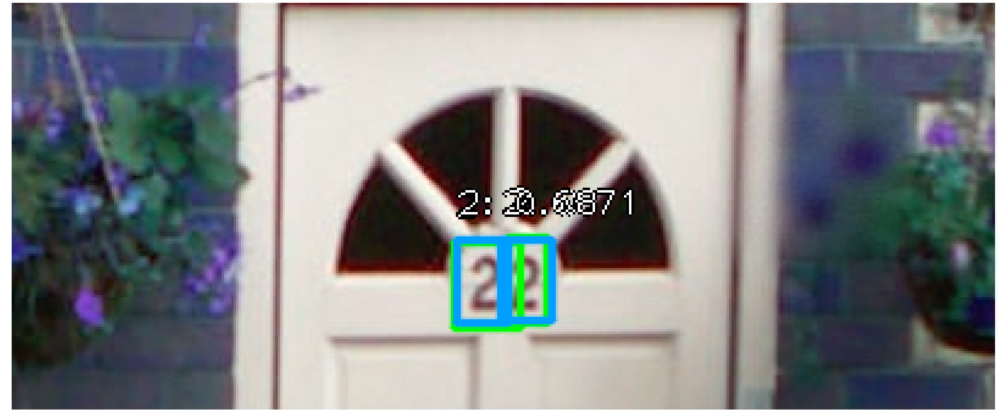

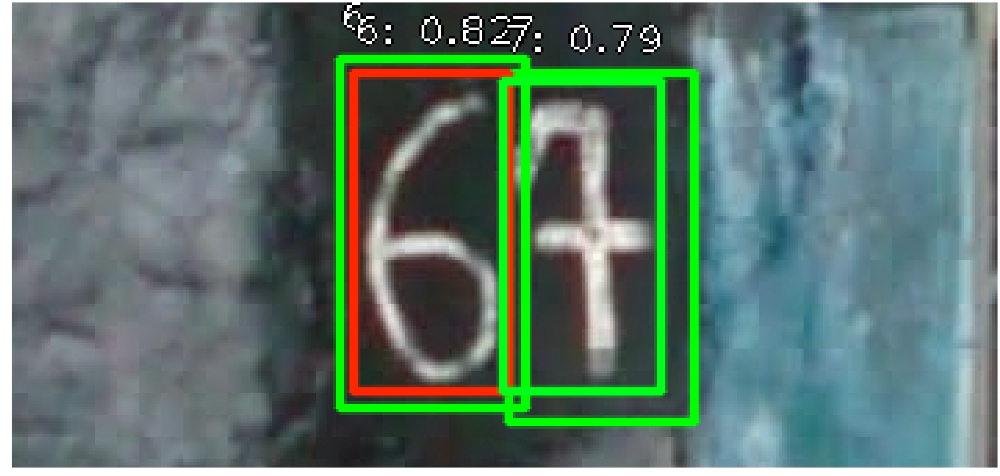

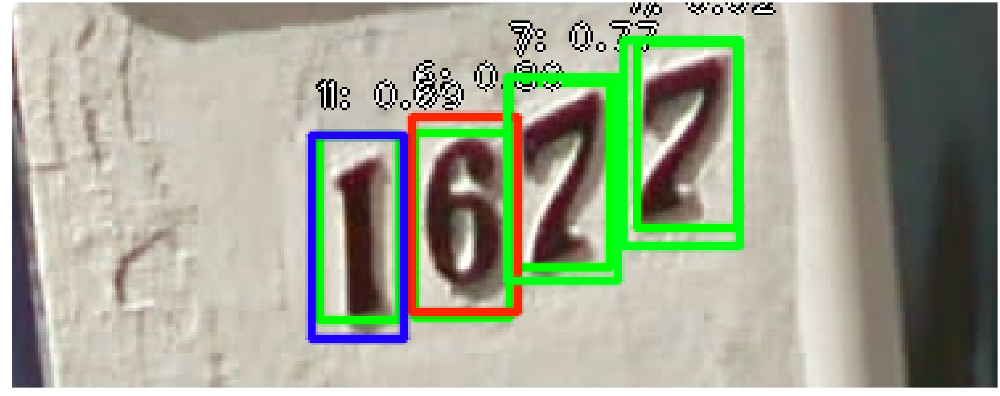

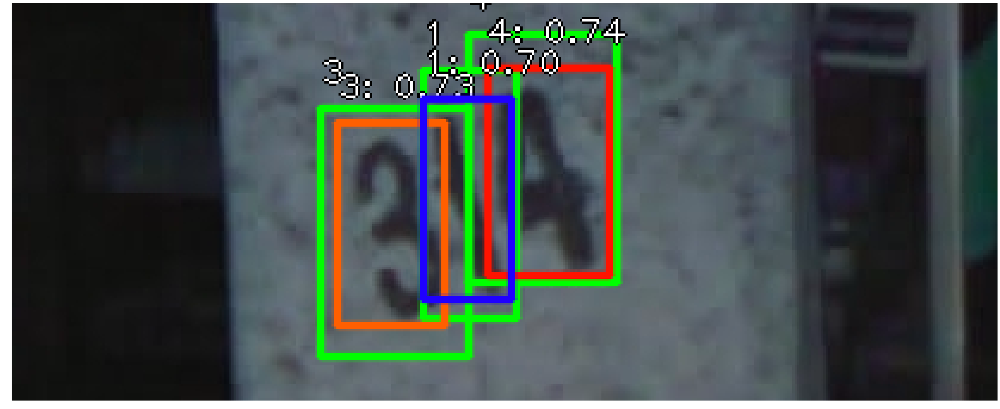

...

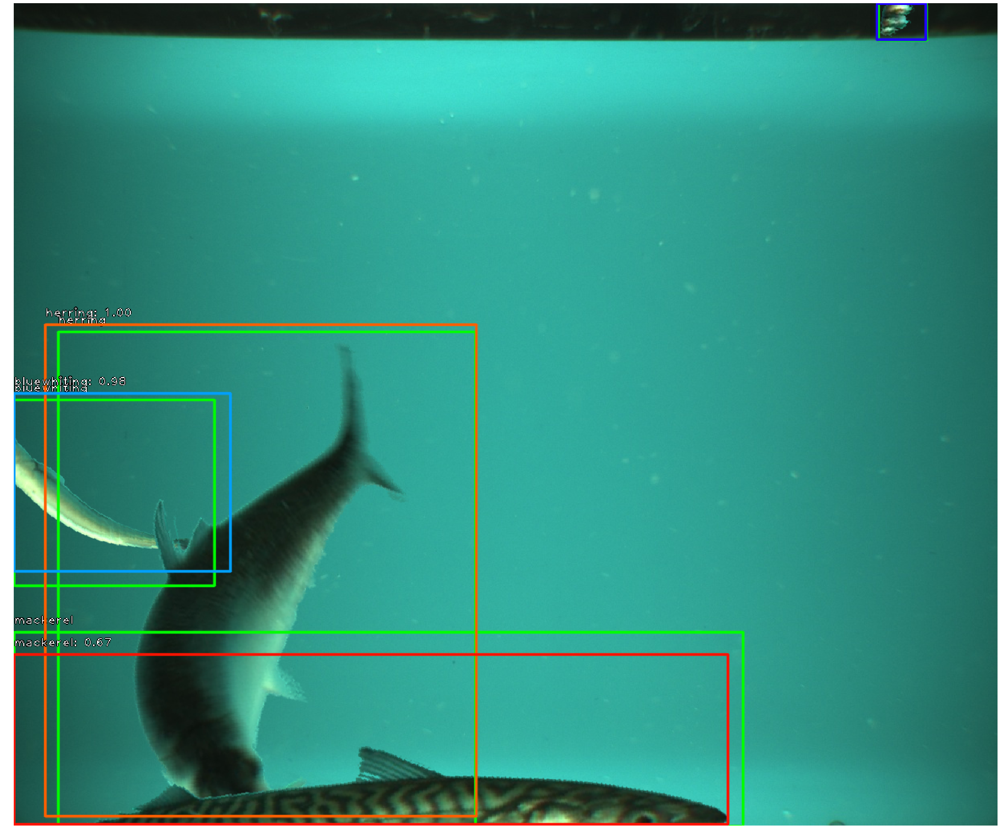

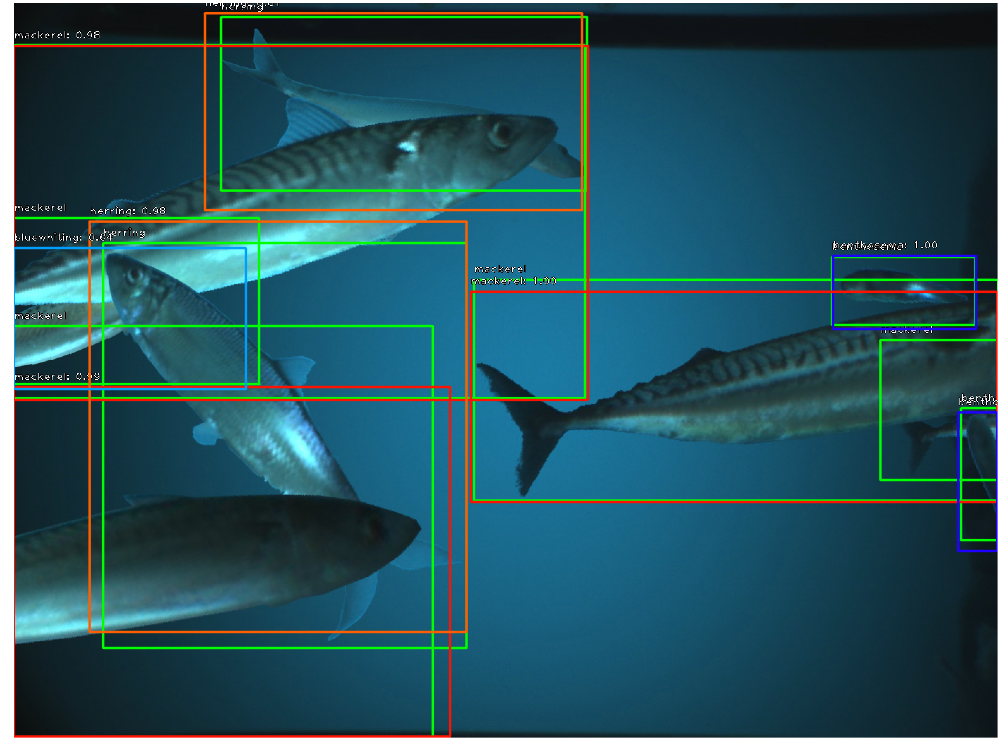

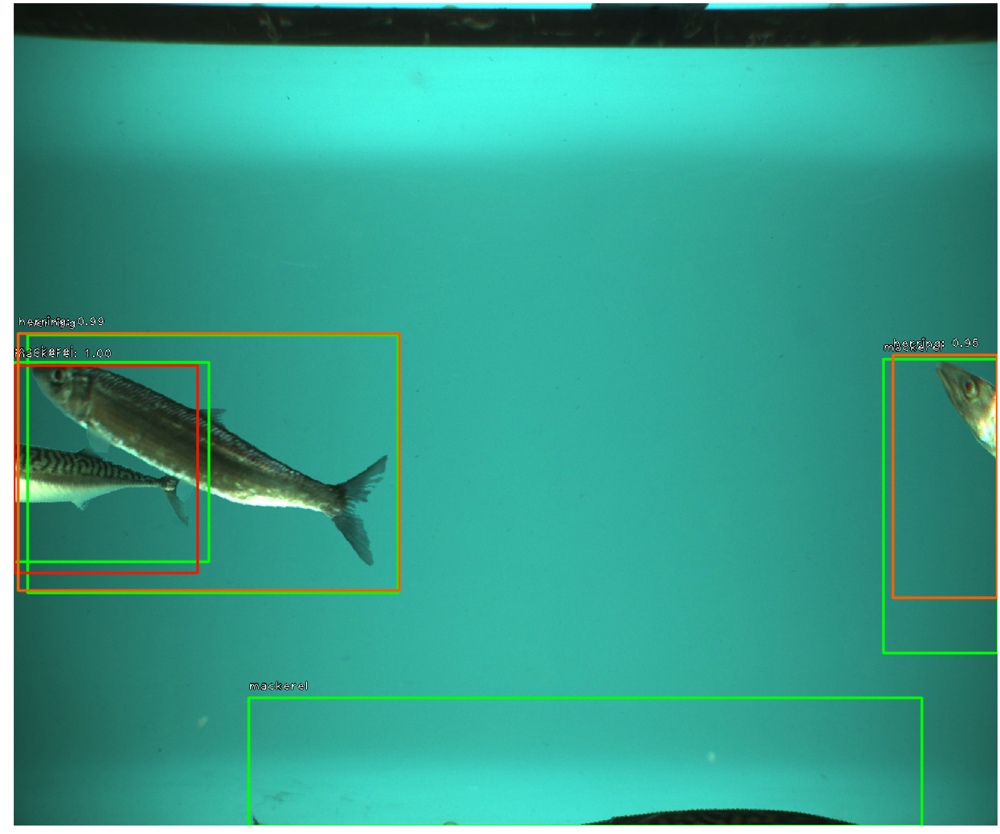

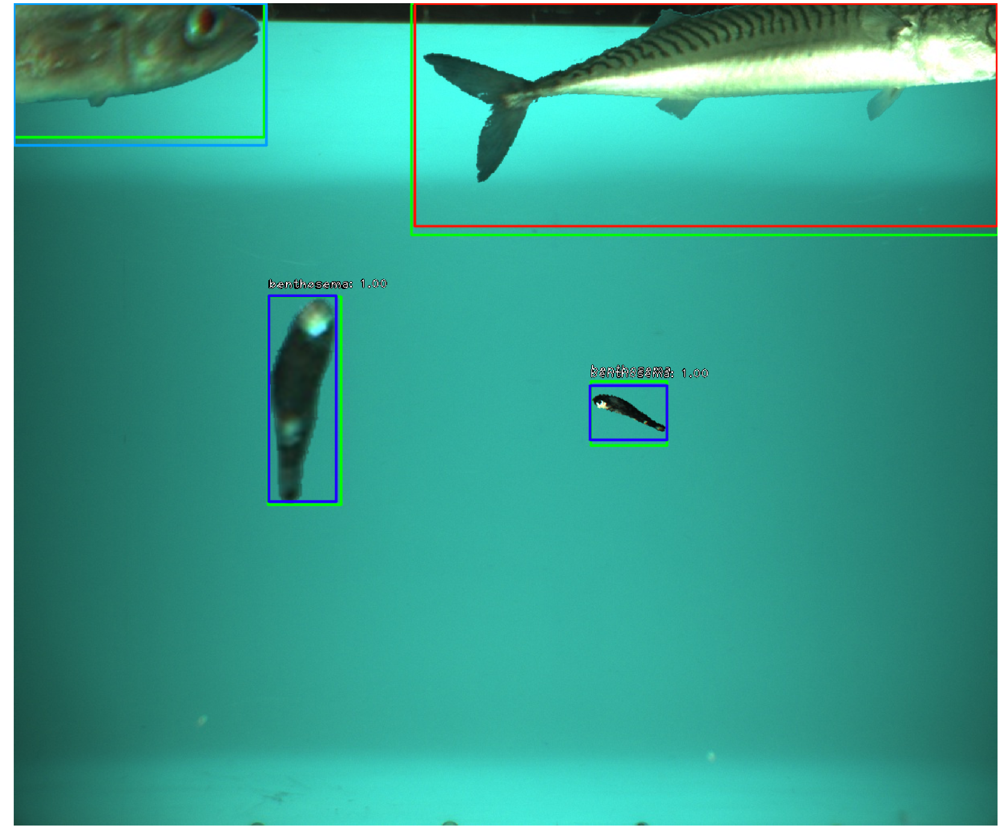

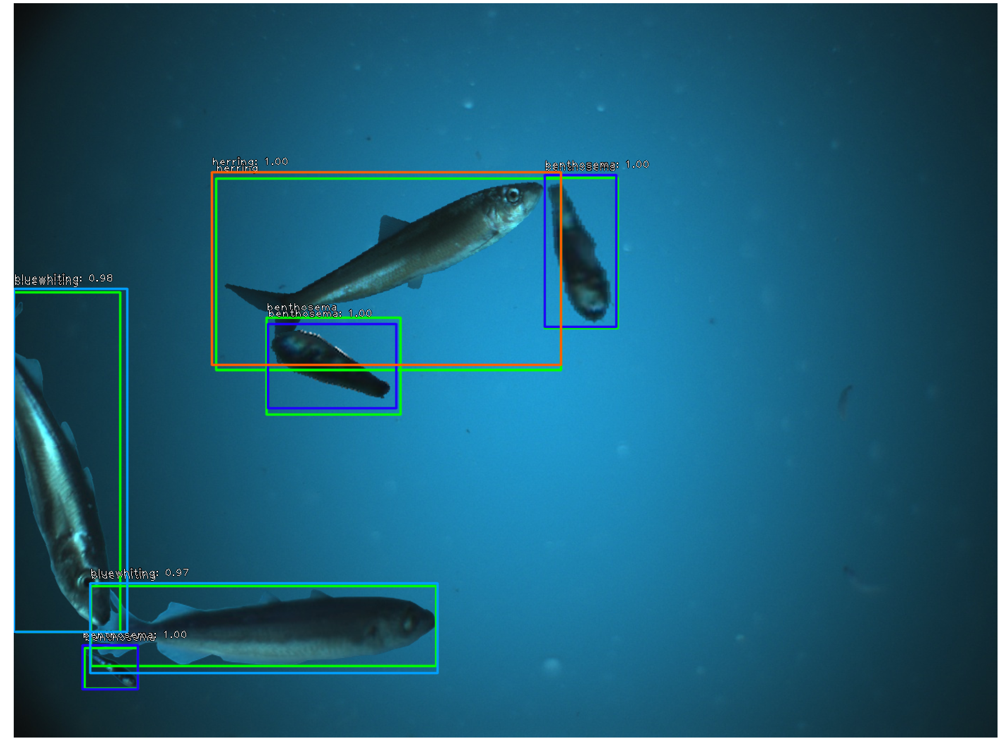

In [93]:
import matplotlib.pyplot as plt
import cv2

for img_dir, img_inds in zip(('svhn_predicted_images', 'fish_predicted_images'), (svhn_images, fish_images)):
    biggest_images = sorted(os.listdir(img_dir), key=lambda filename: -os.path.getsize(os.path.join(img_dir, filename)))
    for ind in img_inds:
        img = cv2.imread(img_dir + '/' + biggest_images[ind])
        plt.figure(figsize=(50, 50))
        plt.imshow(img)
        plt.axis('off')
        plt.show()

# Conclusion:

The model performed well on both SVHN and FISH images. Especially for fish images we saw examples above of the model being able to handle overlapping and partially unobservable objects with relative ease. It was also easy to implement and did not require us to specify and bounding boxes or much fine tuning at all.

# Future work:

In order to improve the accuracy further it could be an idea to swap out the ResNet50 backbone with something bigger like ResNet152. Another potentially helpfull idea for SVHN digit classification would be to transform the SVHN images to grayscale images by scaling the RBG values of each image by a factor of (0.2989, 0.5870, 0.1140)